In [10]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy import stats
import seaborn as sns

In [12]:
solar = pd.read_csv('https://www.eia.gov/consumption/residential/data/2015/csv/recs2015_public_v4.csv')

In [15]:
solar.columns = solar.columns.str.lower()
solar.head()

,doeid,regionc,division,metromicro,uatyp10,typehuq,ztypehuq,cellar,zcellar,basefin,...,zelamount,ngxbtu,periodng,zngamount,foxbtu,periodfo,zfoamount,lpxbtu,periodlp,zlpamount
0,10001,4,10,METRO,U,2,0,0,0,-2,...,0,103.32,1,0,137.45,-2,-2,91.33,-2,-2
1,10002,3,7,NONE,R,2,0,0,0,-2,...,1,NaN,-2,-2,137.45,-2,-2,91.33,-2,-2
2,10003,3,6,METRO,U,2,0,1,0,1,...,0,100.14,1,0,137.45,-2,-2,91.33,-2,-2
3,10004,2,4,MICRO,C,2,0,1,0,1,...,0,NaN,-2,-2,137.45,-2,-2,91.33,2,0
4,10005,1,2,METRO,U,2,0,1,0,0,...,0,102.83,1,0,137.45,-2,-2,91.33,-2,-2


In [20]:
solar.columns

Index(['doeid', 'regionc', 'division', 'metromicro', 'uatyp10', 'typehuq',
       'ztypehuq', 'cellar', 'zcellar', 'basefin',
       ...
       'zelamount', 'ngxbtu', 'periodng', 'zngamount', 'foxbtu', 'periodfo',
       'zfoamount', 'lpxbtu', 'periodlp', 'zlpamount'],
      dtype='object', length=759)

In [18]:
df = pd.read_csv('https://tf-assets-prod.s3.amazonaws.com/tf-curric/data-science/computers.csv', index_col=0)

In [19]:
df.head()

,price,speed,hd,ram,screen,cd,multi,premium,ads,trend
1,1499,25,80,4,14,no,no,yes,94,1
2,1795,33,85,2,14,no,no,yes,94,1
3,1595,25,170,4,15,no,no,yes,94,1
4,1849,25,170,8,14,no,no,no,94,1
5,3295,33,340,16,14,no,no,yes,94,1


In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6259 entries, 1 to 6259
Data columns (total 10 columns):
price      6259 non-null int64
speed      6259 non-null int64
hd         6259 non-null int64
ram        6259 non-null int64
screen     6259 non-null int64
cd         6259 non-null object
multi      6259 non-null object
premium    6259 non-null object
ads        6259 non-null int64
trend      6259 non-null int64
dtypes: int64(7), object(3)
memory usage: 537.9+ KB


In [25]:
df.describe()

,price,speed,hd,ram,screen,ads,trend
count,6259.000000,6259.000000,6259.000000,6259.000000,6259.000000,6259.000000,6259.000000
mean,2219.576610,52.011024,416.601694,8.286947,14.608723,221.301007,15.926985
std,580.803956,21.157735,258.548445,5.631099,0.905115,74.835284,7.873984
min,949.000000,25.000000,80.000000,2.000000,14.000000,39.000000,1.000000
25%,1794.000000,33.000000,214.000000,4.000000,14.000000,162.500000,10.000000
50%,2144.000000,50.000000,340.000000,8.000000,14.000000,246.000000,16.000000
75%,2595.000000,66.000000,528.000000,8.000000,15.000000,275.000000,21.500000
max,5399.000000,100.000000,2100.000000,32.000000,17.000000,339.000000,35.000000


In [33]:
df.screen.value_counts()

14    3661
15    1992
17     606
Name: screen, dtype: int64

(array([ 48., 132., 154., 146.,  56.,  38.,  19.,   7.,   3.,   3.]),
 array([1418. , 1816.1, 2214.2, 2612.3, 3010.4, 3408.5, 3806.6, 4204.7,
        4602.8, 5000.9, 5399. ]),
 <a list of 10 Patch objects>)

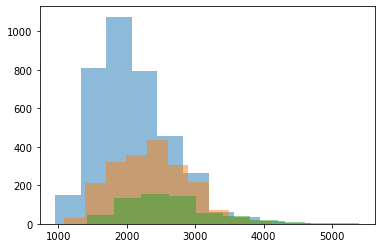

In [22]:
plt.hist(df.loc[df.screen == 14].price, alpha=.5)
plt.hist(df.loc[df.screen == 15].price, alpha=.5)
plt.hist(df.loc[df.screen == 17].price, alpha=.5)

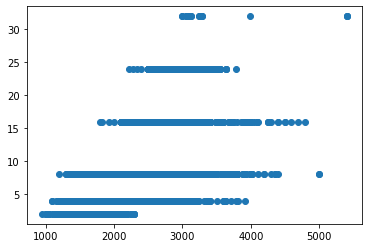

In [23]:
plt.plot(df['price'], df['ram'], 'o')

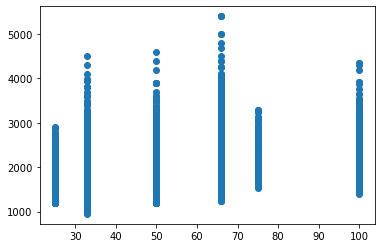

In [24]:
plt.plot(df.speed, df.price, 'o')

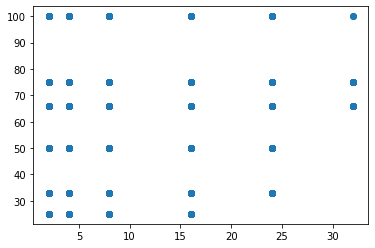

In [17]:
plt.plot(df.ram, df.speed, 'o')

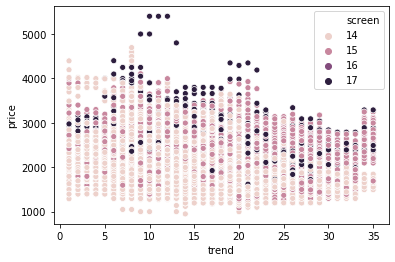

In [34]:
sns.scatterplot('trend', 'price', data=df, hue='screen')

Text(0.5, 1.0, 'Price over Time')

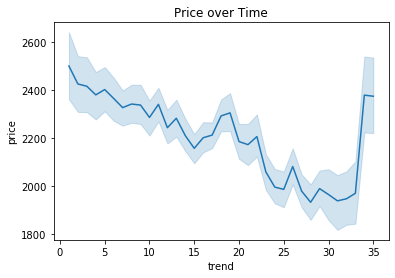

In [38]:
sns.lineplot('trend', 'price', data=df)
plt.title('Price over Time')

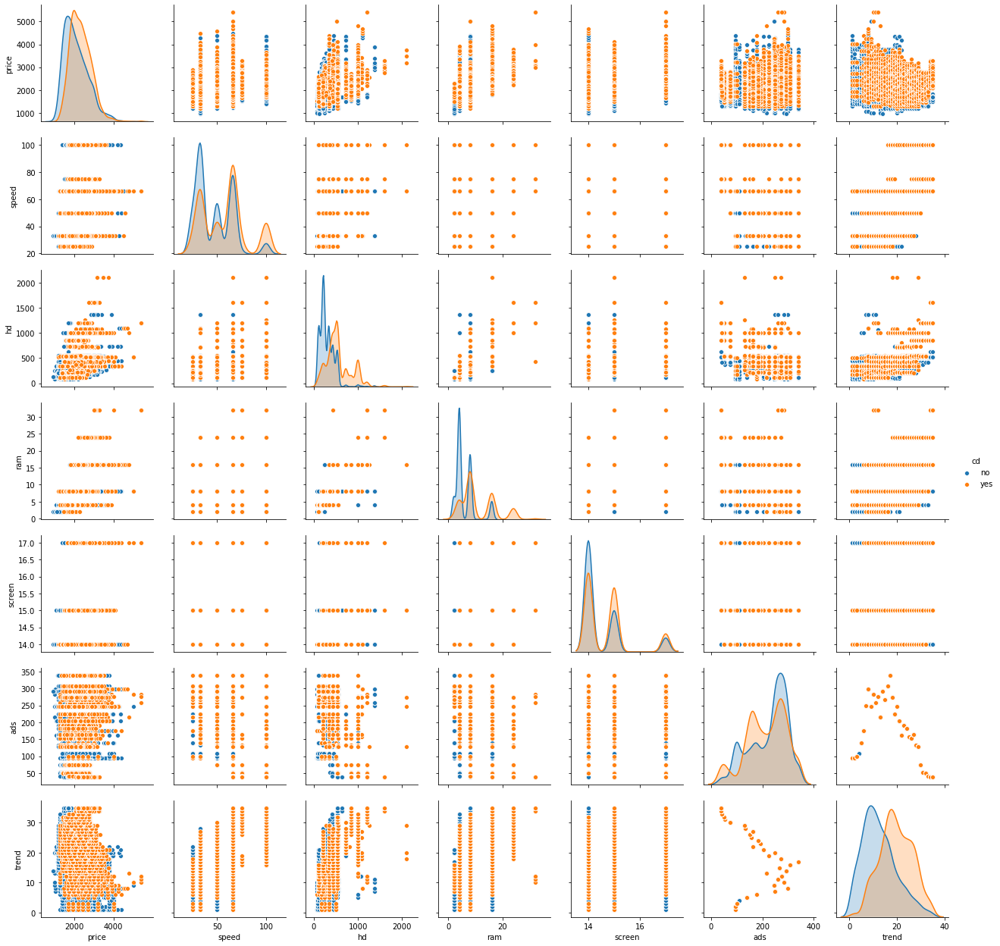

In [39]:
sns.pairplot(df, hue='cd')

In [50]:
df = df.assign(screen_cat = lambda x: if df['screen'] == 14: 'small')

SyntaxError: invalid syntax (<ipython-input-50-5c8a4e9bf719>, line 1)

In [ ]:
sns.pairplot(df, hue='screen_cat')

In [46]:
df.head()

,price,speed,hd,ram,screen,cd,multi,premium,ads,trend,screen_cat
1,1499,25,80,4,14,no,no,yes,94,1,1 14\n2 14\n3 15\n4 14...
2,1795,33,85,2,14,no,no,yes,94,1,1 14\n2 14\n3 15\n4 14...
3,1595,25,170,4,15,no,no,yes,94,1,1 14\n2 14\n3 15\n4 14...
4,1849,25,170,8,14,no,no,no,94,1,1 14\n2 14\n3 15\n4 14...
5,3295,33,340,16,14,no,no,yes,94,1,1 14\n2 14\n3 15\n4 14...
